# Modèle d'Ising en 2D
# Exploration d'outils d'analyse numérique pour un système simple

## Introduction

Dans le modèle d'Ising, les spins $S_i$ sont définis sur un réseau bidimensionnel et peuvent prendre les valeurs $+1$ ou $-1$, représentant respectivement les moments magnétiques orientés vers le haut ou vers le bas.

L'énergie du système est donnée par l'Hamiltonien :

$$
H = -J \sum_{\langle i,j \rangle} S_i S_j - h \sum_i S_i
$$

où :
- $J$ est l'interaction entre spins voisins,
- $h$ est relié au champ magnétique externe,
- $\langle i,j \rangle$ représente la somme sur les paires de spins voisins.


---

> __Objectifs__
>
> 1. explorer les différents régimes (température, champs extérieur, conditions limites, voisins...)
> 2. <u>Caractériser la transition de phase</u> ($T_c = 2.269$) : 4 outils
>       1. Magnétisation moyenne
>       2. exposants critiques
>       3. correlations
>       4. dimension fractale des interfaces
>
> - **Étude à l'équilibre** : $N \sim 50 - 150 \longrightarrow n_{steps, eq} \sim 1000-10000$ 
---
.

## Méthode : simulation par Monte Carlo

Nous utilisons un algorithme de Monte Carlo basé sur le critère de Metropolis pour simuler l'évolution du modèle d'Ising. 

L'évolution du système est obtenue en retournant aléatoirement un spin et en acceptant ce changement selon la probabilité de Metropolis :

$$
P = \min\left(1, \exp\left(\frac{-\Delta E}{k_B T}\right)\right)
$$

où $\Delta E$ est la différence d'énergie calculée sur les voisins du spin considéré.

> **Stratégie d'implémentation**
> 1. la fonction de partition n'est pas nécéssaire (rapport de probabilité)
> 3. on peut paralléliser métropolis sur des sous-réseaux de spins assez éloignés (=non voisins)
> 4. utiliser une classe pour décrire le modèle d'ising 


(**Algorithme de Wolff** accélérer l'étude à l'équilibre, non implémenté ici)

In [1]:
import numpy as np
import scipy
import scipy.signal as signal
import scipy.constants
import scipy.optimize
import scipy.ndimage

import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from matplotlib.animation import FuncAnimation

%matplotlib notebook
%matplotlib inline
from IPython.display import HTML
import ipywidgets as widgets


from utils import *

In [20]:
class IsingModel:
    
    def __init__(self, N=50, kernel=None, J=1, h=0, T=1, lattice_init=None, boundary:str='periodic'):
        self.N = N
        self.T = T
        self.h = h
        self.J = J
        self.kB = 1 #scipy.constants.k

        if lattice_init is None:
            lattice_init = np.random.choice([-1, 1], size=(self.N, self.N))
        
        elif lattice_init.shape != (self.N,self.N):
            raise ValueError("lattice_init.shape has to be ({},{})".format(self.N,self.N))
        
        self.lattice = lattice_init
        self.boundaries = boundary

        if kernel is None:
            kernel = np.array([[0, 1, 0],
                               [1, 0, 1],
                               [0, 1, 0]])
        self.kernel = kernel
        self.sublattice_size = self.kernel.shape[0]//2 +1
        
        self.frames = []
        self.h_frames = []
        self.T_frames = []
        self.M_frames = []

    # State 
    def plot(self):
        fig, ax = plt.subplots()
        img = ax.imshow(self.lattice, cmap='gray', interpolation='nearest', vmin=-1, vmax=1)

        # Custom legend
        legend_elements = [
            Patch(facecolor='white', edgecolor='black', label='Spin Up'),
            Patch(facecolor='black', label='Spin Down')]
        
        # Position the legend outside the plot area
        ax.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1, 1), frameon=True)

        ax.set_title('2D Ising Model Animation, T={:.2f}, M={:.2f}'.format(self.T, self.magnetization()))

        ax.set_xticks([])  # Hide x ticks
        ax.set_yticks([])  # Hide y ticks
        
        plt.tight_layout()  # Adjust layout to make room for the legend
        plt.show()
    def magnetization(self):
        return np.sum(self.lattice) / self.lattice.shape[0]**2
    def energy_grid(self):
        if self.boundaries == 'periodic':
            return -self.h*self.lattice - self.J* self.lattice* signal.convolve2d(self.lattice, self.kernel, mode='same', boundary='wrap')
        if self.boundaries == 'fixed_opposite':
            lattice_pad = padd_opposite_bound(self.lattice)
            return -self.h*self.lattice - self.J* self.lattice* signal.convolve2d(lattice_pad, self.kernel, mode='valid')
        
    # Time evolution
    def one_step(self):
        # CHOOSE SUBLATTICE (idx = boolean indexing)
        m0, m1 = np.random.randint(self.sublattice_size+1, size=(2))
        idx = np.zeros(shape=self.lattice.shape, dtype=bool)
        idx[m0::self.sublattice_size, m1::self.sublattice_size] = True

        # METROPOLIS STEP
        delta_H = -2* self.energy_grid()
        
        proba = np.minimum(1, np.exp(-delta_H[idx] / (self.kB *self.T) ))
        flip = np.random.uniform(size=proba.shape) < proba
        self.lattice[idx] *= np.where(flip, -1, 1)  # if flip=True, then *-1

        # SAVE PARAMETERS
        self.T_frames.append(self.T)
        self.h_frames.append(self.h)
        self.M_frames.append(self.magnetization())
    def simulate(self, n_steps, Ti=None, Tf=None, exp_decay=None, save_frames=False, verbose=False):

        # define temperatures during simulation
        if Ti is None: Ti = self.T
        if Tf is None: list_T = [Ti]*n_steps
        else:
            if exp_decay:
                list_T = [Tf + (Ti-Tf)*np.exp(-exp_decay* step/n_steps) for step in range(n_steps)]
            else:
                list_T = list(np.linspace(Ti, Tf, n_steps))
        
        # simulation
        for step, T in enumerate(list_T):
            if step%100 == 0 and verbose:
                print(f"Step {step}/{n_steps}: Magnetization = {self.magnetization()}, Temperature = {self.T:.2f}")
                
            if save_frames & step%20==0: #pour ne sauver que tous les 10 images
                self.frames.append(self.lattice.copy())
            
            self.T = T
            self.one_step()

    # Animation
    def animate(self):
        """Create an animation of the Ising model simulation."""
        fig, ax = plt.subplots()
        img = ax.imshow(self.frames[0], cmap='gray', interpolation='nearest', vmin=-1, vmax=1)
        ax.set_title('2D Ising Model Animation, T={:.2f}'.format(self.T_frames[0]))
        
        legend_elements = [
            Patch(facecolor='white', edgecolor='black', label='Spin Up'),
            Patch(facecolor='black', label='Spin Down')]
        
        # Position the legend outside the plot area
        ax.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1, 1), frameon=True)
        
        ax.set_xticks([])  # Hide x ticks
        ax.set_yticks([])  # Hide y ticks
        
        def update(frame):
            img.set_array(self.frames[frame])
            ax.set_title('2D Ising Model Animation, T={:.2f}'.format(self.T_frames[frame]))
            return img,
            
        plt.close(fig) #pour ne pas avoir l'image qui s'affiche en plus de la vidéo
        
        return HTML(FuncAnimation(fig, update, frames=len(self.frames), interval=5000/len(self.T_frames), blit=True).to_jshtml())

    # graph magnetization
    def graph_magnetization(self, Ti, Tf, dT, n_samples, n_sample_close=100, n_eq=1000, n_first_eq=3000):

        if Tf > 2.4 :
            T_list = np.sort( np.concatenate([np.arange(Ti, Tf, dT), np.arange(2.2, 2.4, 0.01)]) )

        else :
            T_list = np.arange(Ti, Tf, dT)
            
        M_measurements = np.zeros((T_list.shape[0], 2))

        self.T = Ti
        self.simulate(n_first_eq)

        for i, T in enumerate(T_list):
            self.T = T
            self.simulate(n_eq)

            M_list = []

            n_mean = n_samples
            if 2.2 < T and T < 2.4:
                n_mean = n_sample_close
            for _ in range(n_mean):
                M_list.append(self.magnetization())
                self.simulate(n_eq)
            M_measurements[i, 0] = float(np.mean(M_list))
            M_measurements[i, 1] = float(np.std(M_list))
        
        return T_list, M_measurements

    # Correlation methods
    def correlation(self,neighbour_choice):

        nb_distances = self.N//2 + 1
        correlation_values = np.zeros(nb_distances)

        for d in range(nb_distances):
            neighbour = neighbour_choice(d)
            correlation_matrix = self.lattice * signal.convolve2d(self.lattice, neighbour, mode='same', boundary='wrap')
            correlation_values[d] = np.sum(correlation_matrix)
        
        return correlation_values/(self.N**2)
    def calculate_xi(self,correlation):
        TF_0 = np.sum(correlation)  
        TF_2pi_L = np.sum([correlation[d] * 2 * np.cos(2*np.pi*d / self.N) for d in range(len(correlation))])
        
        xi = (self.N / (2 * np.pi)) * np.sqrt(TF_0 / TF_2pi_L - 1)
        return xi
        
    # Fractals methods
    def get_main_interface(self, plot=False):
        
        # find the main connexe cluster
        A = padd_opposite_bound(self.lattice.copy())
        A[A==-1] = 0

        f1 = remove_non_border_components(A)
        f  = remove_non_border_components(np.logical_not(f1))

        # find the lenght of the interface
        kernel = self.kernel
        cov = signal.convolve2d(f, kernel, mode='valid')

        cov[cov==4] = 0
        interface = cov*A[1:-1, 1:-1]
        
        if plot:
            plt.imshow(~f, cmap='gray')
            plt.title('Main connex cluster, lenght={}'.format(np.sum(interface)))

        return interface
    def get_fractal_dimension(self, plot=False):
        interface = self.get_main_interface(plot=plot)
        if plot:
            plt.show()
            plt.imshow(interface)
            plt.show()
        
        curve = interface.copy()
        curve[curve!=0] = 1

        curve_coordinates = np.column_stack(np.nonzero(curve))

        box_sizes = np.linspace(3, 20, 100)
        dimension = fractal_dimension(curve_coordinates, box_sizes=box_sizes, plot=plot)
        
        return dimension
    def graph_fractal_dimension(self, T_list=np.arange(0.001, 3, 0.05), n_sample=10, n_eq=2000, plot=False):
        
        D_measurements = np.zeros((len(T_list), 2))

        for i, T in enumerate(T_list):
            self.T = T
            D_T_list = []
            for _ in range(n_sample):
                self.simulate(n_eq)
                D_T_list.append(self.get_fractal_dimension())
            D_measurements[i, 0] = float(np.mean(D_T_list))
            D_measurements[i, 1] = float(np.std (D_T_list))

        if plot:
            plt.errorbar(T_list, D_measurements[:, 0], yerr=D_measurements[:, 1],
             
             fmt='o', color='red', markersize=3, 
             ecolor='orange', capsize=2,
             label='Mean over {} points with {} equilibrations steps'.format(n_sample, n_eq)
             )
            plt.axvline(x=2.269, label='Tc', ls='--', c='gray')
            plt.xlabel('T')
            plt.ylabel('fractal dimension')
            plt.title('Fractal dimension around the transition')
            plt.legend()
            
        return T_list, D_measurements

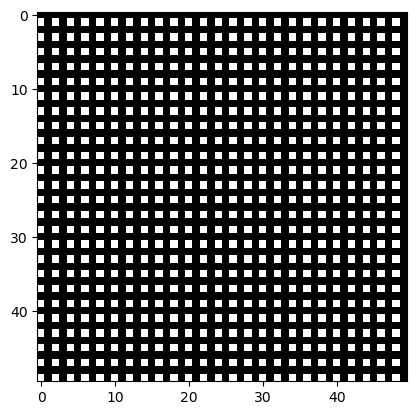

In [35]:
N=50
sublattice_size = 2

m0, m1 = np.random.randint(sublattice_size+1, size=(2))
idx = np.zeros(shape=(N, N), dtype=bool)
idx[m0::sublattice_size, m1::sublattice_size] = True

plt.imshow(idx, cmap='gray')

## 1. Visualisation des différents régimes

### Régime haute température

In [3]:
model = IsingModel(T=3)
model.simulate(1000,save_frames=True)
model.animate()

Text(0, 0.5, '$<M>$')

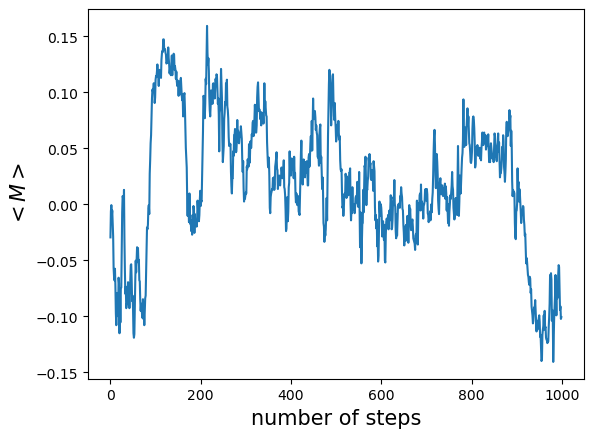

In [4]:
plt.figure()
plt.plot(model.M_frames)
plt.xlabel(r'number of steps',fontsize=15)
plt.ylabel(r'$<M>$',fontsize=15)

### Régime basse température : équilibre stable

In [76]:
model = IsingModel(T=1)
model.simulate(2000,save_frames=True)
model.animate()

Text(0, 0.5, '$<M>$')

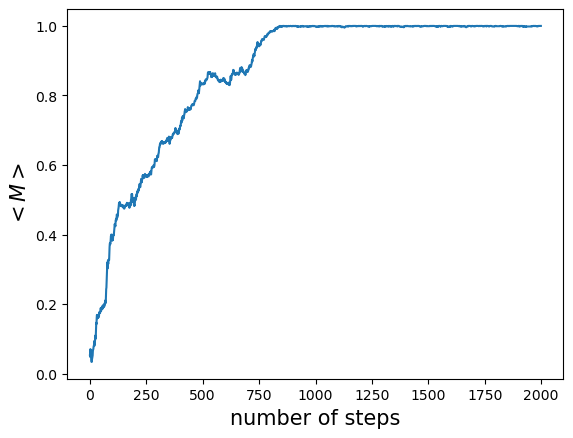

In [77]:
plt.figure()
plt.plot(model.M_frames)
plt.xlabel(r'number of steps',fontsize=15)
plt.ylabel(r'$<M>$',fontsize=15)

### Régime basse température : métastabilité due au réseau périodique

In [5]:
model = IsingModel(T=1)
model.simulate(2000,save_frames=True)
model.animate()

Text(0, 0.5, '$<M>$')

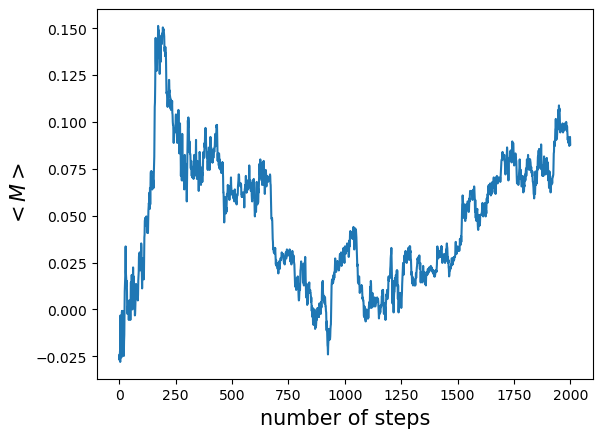

In [6]:
plt.figure()
plt.plot(model.M_frames)
plt.xlabel(r'number of steps',fontsize=15)
plt.ylabel(r'$<M>$',fontsize=15)

## 2. Transition de phase : 4 outils



### 2.1 Magnétisation moyenne

Pour étudier la transition de phase, nous allons calculer la magnétisation moyenne $ \langle M \rangle $ en fonction de la température. 

In [670]:
model = IsingModel(lattice_init=np.ones((50,50)))

T_list, M_list = model.graph_magnetization(Ti=0.01, Tf=3, dT=0.05, 
                                           n_samples=10, n_sample_close=500,
                                           n_eq=1000, n_first_eq=3000)

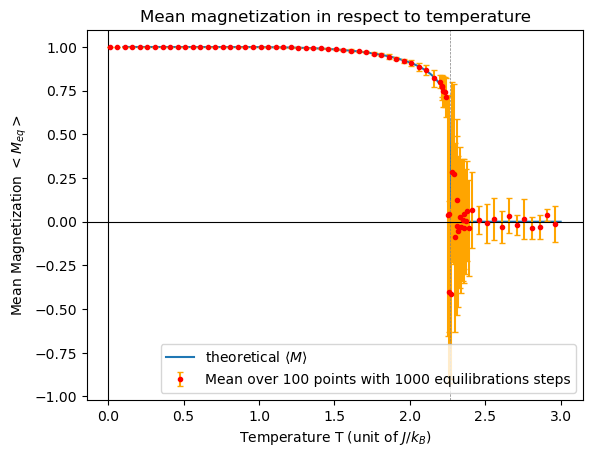

In [671]:
def magnetization_th(T, Tc=2.269, M_max=1):
    # For T < Tc
    if T < Tc:
        return M_max * (1 - 1 / (np.sinh(2 / T)**4))**(1/8)
    # For T >= Tc
    else:
        return 0

T_values = np.linspace(0.1, 3, 300)
M_values = [magnetization_th(T) for T in T_values]

plt.plot(T_values, M_values, label=r'theoretical $\langle M \rangle$')

#plt.errorbar(T_list, np.mean(M_list, axis=1), yerr=np.std(M_list, axis=1),
plt.errorbar(T_list, M_list[:,0], yerr=M_list[:,1],

             fmt='o', color='red', markersize=3, 
             ecolor='orange', capsize=2,
             label='Mean over 100 points with 1000 equilibrations steps'
             )

Tc = 2.269 
plt.axvline(x=Tc, linestyle='--', linewidth=0.5, color='gray')

plt.axhline(y=0, color='black', linewidth=0.8)  # Horizontal axis (x-axis)
plt.axvline(x=0, color='black', linewidth=0.8)  # Vertical axis (y-axis)

plt.xlabel(r'Temperature T (unit of $J/k_B$)')
plt.ylabel(r'Mean Magnetization $<M_{eq}>$')
plt.title(r'Mean magnetization in respect to temperature')

plt.legend()


### 2.2 Exposants critiques

$$ \langle M \rangle \sim |T-T_c|^\beta $$
$$ \chi \sim |T -T_c|^{-\gamma} $$


> en cours !

### 2.3 Correlation

- Longueur de correlation $\xi$ : $$C(d) = \langle S_i S_j \rangle = \exp\left(- \frac{d_{ij}}{\xi}\right)$$
- Proche de la transition $\xi \sim |T -T_c|^{-\nu}$


> Comment évaluer $\xi$ ?
>
> 1. fit de la loi exponentielle
> 2. transformées de Fourier :

$$ \mathrm{S} \left(\vec{q}\right) = TF [<S_i S_j>] = \frac{1}{N} \sum_{i,j} <S_i S_j> \exp(i \vec{q} \cdot (\vec{r}_i - \vec{r}_j)) = \frac{A}{q^2 + \xi^{-2}}$$ 

On a alors : $$\xi = \frac{L}{2\pi}\sqrt{\frac{S\left(\vec{q} = (0,0)\right)}{S\left(\vec{q} = \left(\frac{2\pi}{L},0\right)\right)}-1}$$

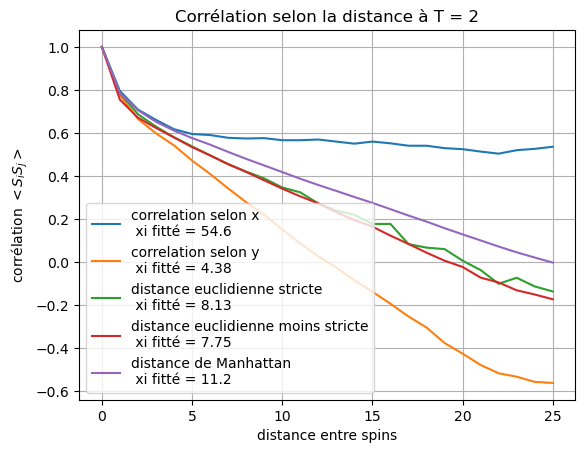

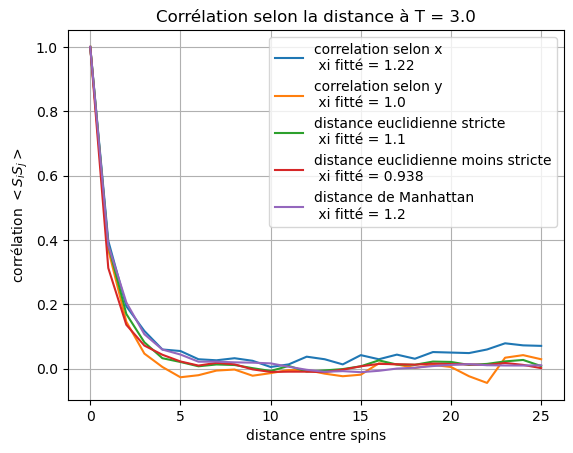

In [37]:

for T in [2, 3.]:
    model = IsingModel(T = T)
    model.simulate(1000)
    #model.plot()

    correlation_list = [model.correlation(x_correlation_kernel),model.correlation(y_correlation_kernel),model.correlation(lambda x : create_circular_kernel(x,0.1)), model.correlation(lambda x : create_circular_kernel(x,0.5)), model.correlation(neighbour_manhattan)]
    correlation_type = ["correlation selon x","correlation selon y","distance euclidienne stricte","distance euclidienne moins stricte","distance de Manhattan"]


    def exp_fit(distances, a, xi):
        return a * np.exp(-distances / xi)

    xi_fit = np.zeros(len(correlation_list))
    xi_FT = np.zeros(len(correlation_list))

    for i in range(len(correlation_list)):
        correlation = correlation_list[i]
        distances = np.arange(len(correlation))
        popt, pcov = scipy.optimize.curve_fit(exp_fit, distances, correlation, p0=[1, 1])
        xi_fit[i] = popt[1]  
        #xi_FT[i] = model.calculate_xi(model.correlation_TF(x_correlation_kernel))


    for i in range(len(correlation_list)):
        #plt.plot(correlation_list[i],label=correlation_type[i] + "\n xi fitté = {:.3} et xi FT = {:.3}".format(xi_fit[i],xi_FT[i]))
        plt.plot(correlation_list[i],label=correlation_type[i] + "\n xi fitté = {:.3}".format(xi_fit[i]))
    
    plt.title("Corrélation selon la distance à T = {}".format(model.T))
    plt.ylabel(r"corrélation $<S_i S_j>$")
    plt.xlabel(r"distance entre spins")
    plt.legend()
    plt.grid()
    plt.show()

### 2.4 dimension fractale des interfaces

On utilise la méthode du comptage de recouvrement.
La dimension fractale $d_f$ d'une courbe est définie par $$N \propto (L/a)^{d_f}$$


![](fractal_box_counting.png)


#### visu pour un reseau

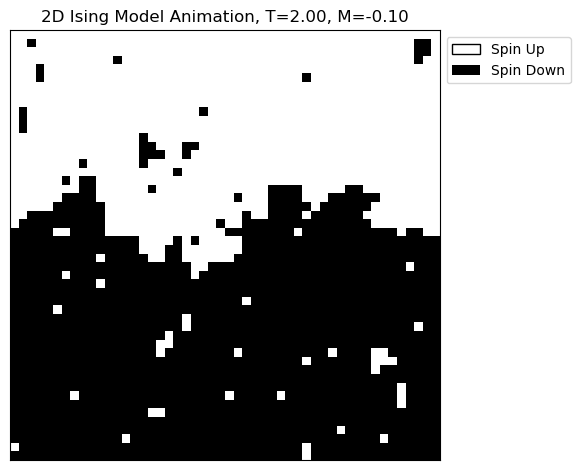

In [23]:
model = IsingModel(boundary='fixed_opposite', T=2.)

model.simulate(10000)
model.plot()

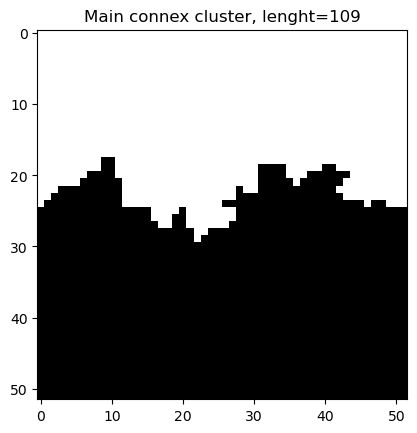

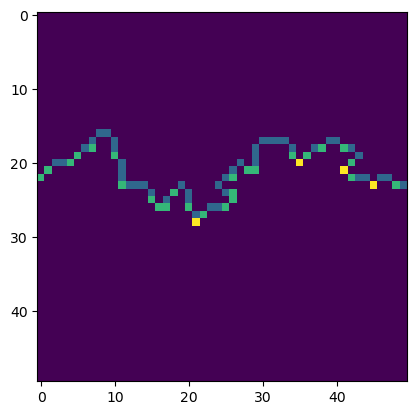

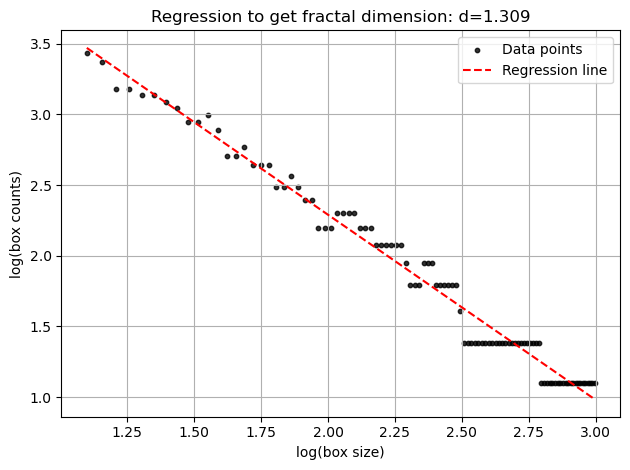

In [24]:
d = model.get_fractal_dimension(plot=True)

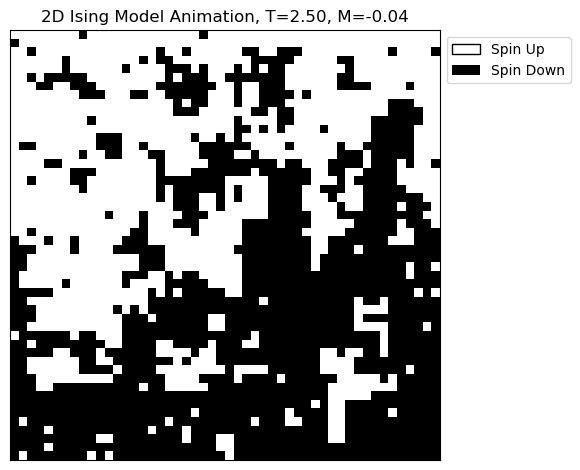

In [27]:
model = IsingModel(boundary='fixed_opposite', T=2.5)

model.simulate(10000)
model.plot()

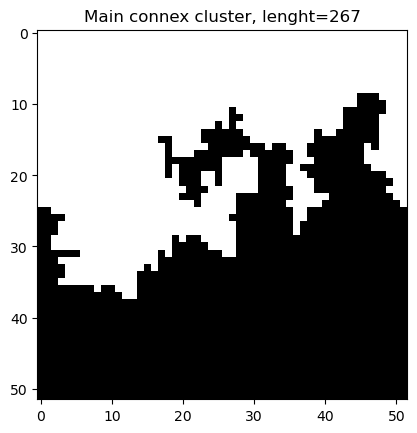

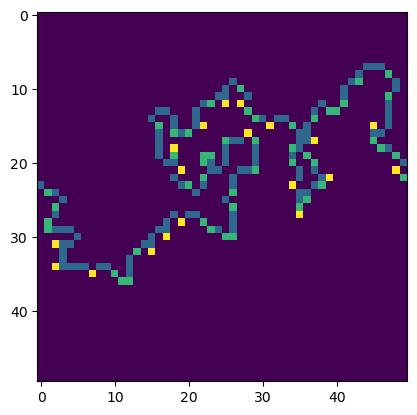

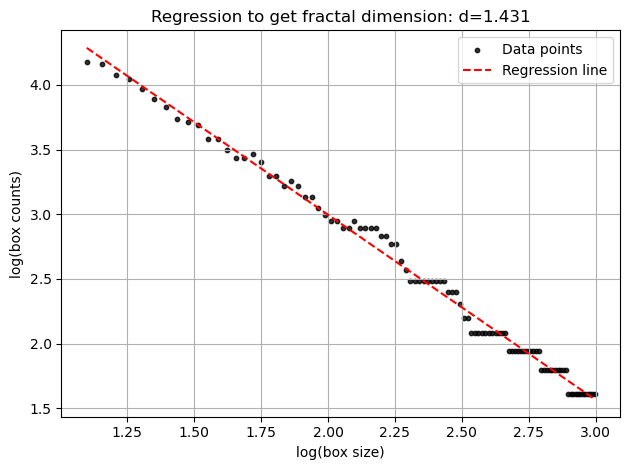

In [28]:
d = model.get_fractal_dimension(plot=True)

#### fractal dimension = f(T)

In [29]:
model = IsingModel(boundary='fixed_opposite')
T_list, D_measurements = model.graph_fractal_dimension(T_list = np.linspace(0.01, 5, 20), n_sample=3, plot=True)

<img src="fractal_temperature.png" alt="Fractal Temperature" width="500"/>

## Annexes

In [9]:
kernels['triangular']

array([[1, 1, 0],
       [1, 0, 1],
       [0, 1, 1]])

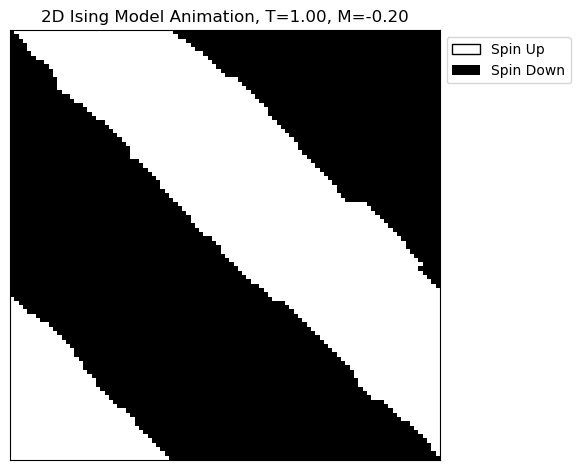

In [8]:
model = IsingModel(N=100, kernel=kernels['triangular'])
model.simulate(10000)
model.plot()

In [4]:
kernels['repulsive_corners']

array([[-3,  0,  1,  0, -3],
       [ 0,  1,  2,  1,  0],
       [ 1,  2,  0,  2,  1],
       [ 0,  1,  2,  1,  0],
       [-3,  0,  1,  0, -3]])

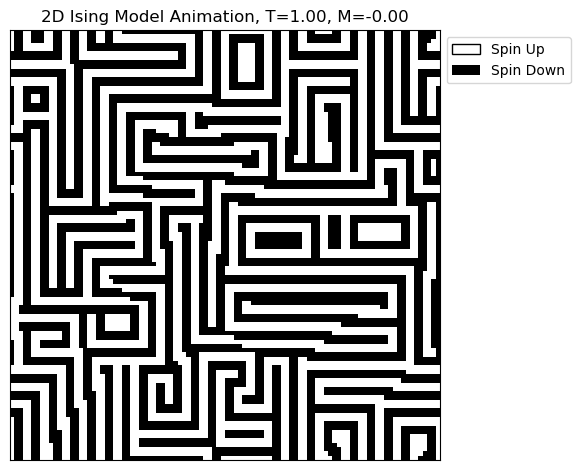

In [11]:
model = IsingModel(N=100, kernel=kernels['repulsive_corners'])
model.simulate(10000)
model.plot()

# Conclusion

- Appliquer une étude statistique plus poussée pour les 4 outils

Ouverture / en cours
- champ non nul
- coefficients critiques
- étude hors équilibre
- kernels exotiques